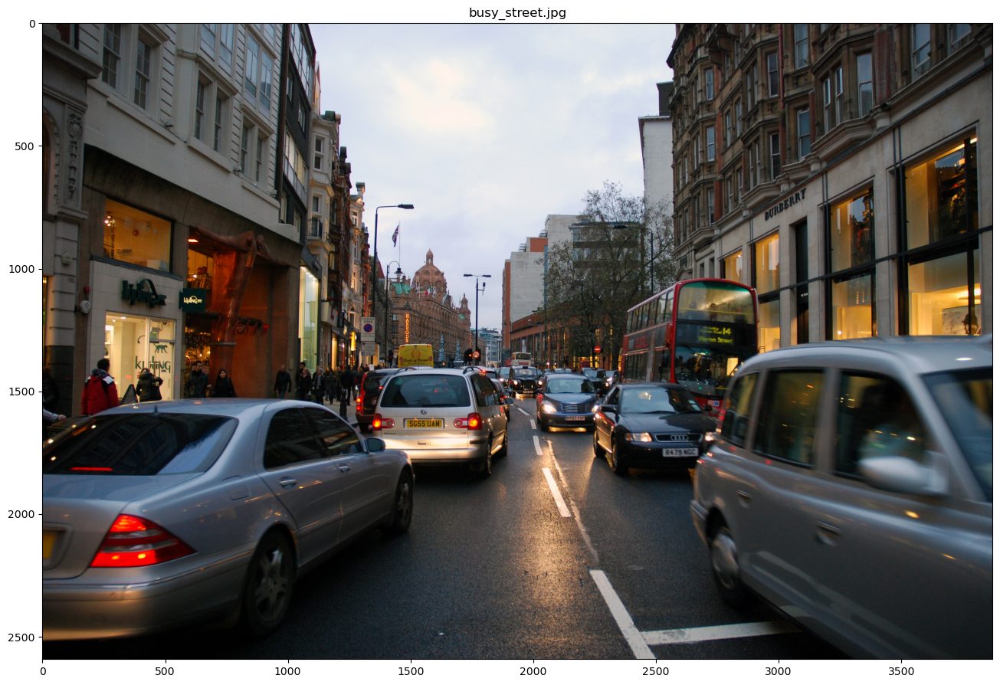

In [1]:
import os
import copy
import numpy as np
from matplotlib.image import imread
import pywt 
import matplotlib.pyplot as plt

plt.rcParams['figure.figsize'] = [16, 16]

data_folder ='data'
image_name = 'busy_street.jpg'
original_image = imread(os.path.join('..', data_folder, image_name))


plt.imshow(original_image)
plt.title(image_name)
plt.show()

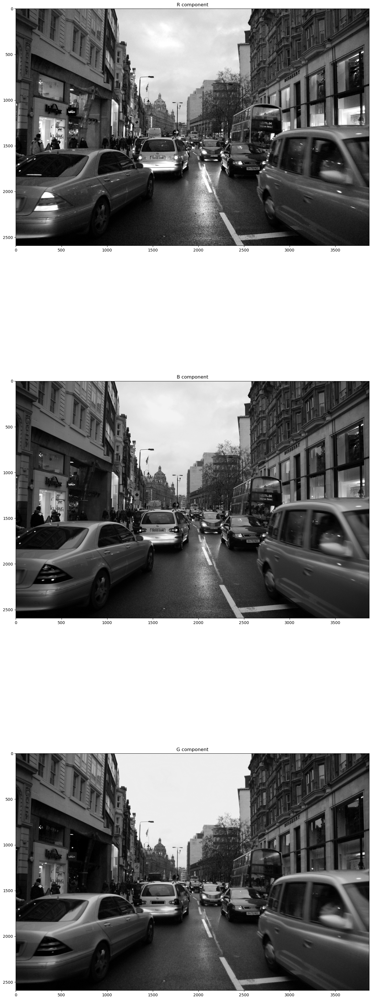

In [2]:
R_component = original_image[:,:,0]
B_component = original_image[:,:,1]
G_component = original_image[:,:,2]

RGB_components = [R_component, B_component, G_component]

titles = ['R component', 'B component', 'G component']

def visualize_RGB_components(RGB_components, titles):

    fig, ax = plt.subplots(3, 1, figsize=(16, 16*3))
    ax = ax.ravel()


    for idx, component in enumerate(RGB_components):
        ax[idx].imshow(component.astype('uint8'), cmap='gray', vmin=0, vmax=255)
        ax[idx].set_title(titles[idx])
    
    plt.show()
visualize_RGB_components(RGB_components, titles)

In [3]:
wavelet_RGB = []
n = 2
wavelet='db1'

for component in RGB_components:
    wavelet_RGB.append(pywt.wavedec2(component, wavelet=wavelet, level=n))

def normalize_coeff(coeff, level):
    coeff[0] /= np.abs(coeff[0]).max()
    
    for detail_level in range(level):
        coeff[detail_level+1] = [d/np.abs(d).max() for d in coeff[detail_level+1]]
    return coeff


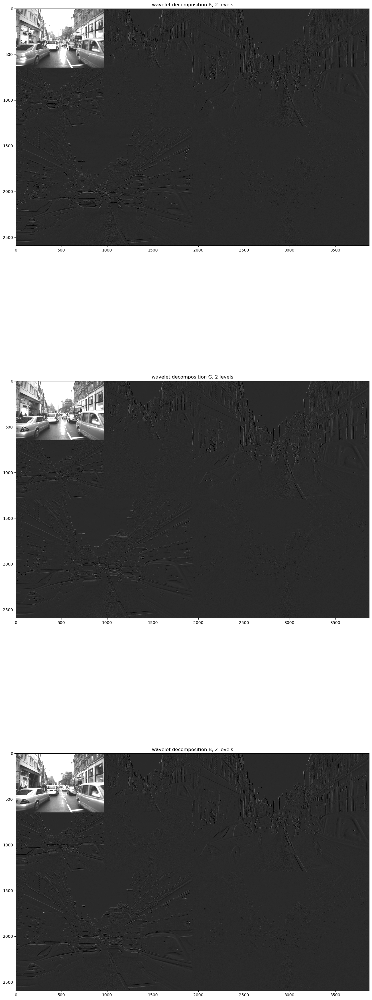

<Figure size 1600x1600 with 0 Axes>

In [4]:
titles = [f'wavelet decomposition R, {n} levels', 
          f'wavelet decomposition G, {n} levels', 
          f'wavelet decomposition B, {n} levels']

def visualize_wavelet_decomposition(wavelet_RGB, titles, n):
    fig, ax = plt.subplots(3, 1, figsize=(16, 16*3))
    ax = ax.ravel()
    

    local_wavelet_RGB = copy.deepcopy(wavelet_RGB)
    for idx in range(len(local_wavelet_RGB)):
        local_wavelet_RGB[idx] = normalize_coeff(local_wavelet_RGB[idx], n)
    
    for idx, component in enumerate(local_wavelet_RGB):
        arr, _ = pywt.coeffs_to_array(component)
        ax[idx].imshow(arr, cmap='gray', vmin=-0.1, vmax=0.5)
        ax[idx].set_title(titles[idx])
    plt.show() 
    plt.tight_layout()

visualize_wavelet_decomposition(wavelet_RGB, titles, n)

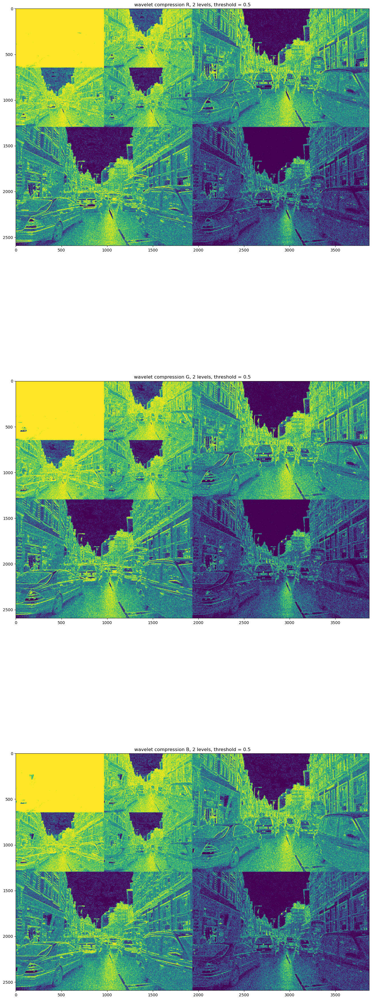

<Figure size 1600x1600 with 0 Axes>

In [6]:
def wavelet_compression(wavelet_RGB, keep=0.8):
    
    local_wavelet_RGB = copy.deepcopy(wavelet_RGB)
    masked_values = [None for i in range(len(wavelet_RGB))]
    for idx, component in enumerate(local_wavelet_RGB):
        
        coeff_arr, slice_arr = pywt.coeffs_to_array(component)
        
        # reshaping to make a copy
        coeff_sorted = np.sort(np.abs(coeff_arr.reshape(-1)))
        
        thresh = coeff_sorted[int(np.floor((1-keep)*len(coeff_sorted)))]
        mask = np.abs(coeff_arr) > thresh
        coeff_filtered = coeff_arr*mask
        
        masked_values[idx] = mask
        local_wavelet_RGB[idx] = pywt.array_to_coeffs(coeff_filtered, slice_arr, output_format='wavedec2')
        
    return local_wavelet_RGB, masked_values

def visualize_mask(masked, titles):
    
    fig, ax = plt.subplots(3, 1, figsize=(16, 16*3))
    ax = ax.ravel()
    for idx, mask in enumerate(masked):
        ax[idx].imshow(mask.astype('int'), cmap='viridis', alpha=1, vmin=0, vmax=1)
        ax[idx].set_title(titles[idx])
    plt.show() 
    plt.tight_layout()
    
    
    
threshold=0.5
titles = [f'wavelet compression R, {n} levels, threshold = {threshold}', 
          f'wavelet compression G, {n} levels, threshold = {threshold}', 
          f'wavelet compression B, {n} levels, threshold = {threshold}']        
wavelet_RGB_compressed, masked_values = wavelet_compression(wavelet_RGB, threshold)
visualize_mask(masked_values, titles)

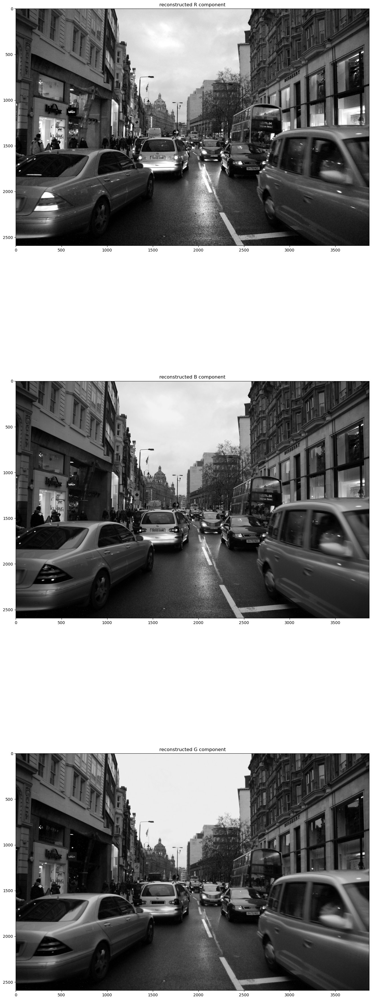

In [7]:
reconstructed_RGB = []

for component in wavelet_RGB_compressed:
    reconstructed_RGB.append(pywt.waverec2(component, wavelet=wavelet))
    
titles = ['reconstructed R component', 'reconstructed B component', 'reconstructed G component']
visualize_RGB_components(reconstructed_RGB, titles)


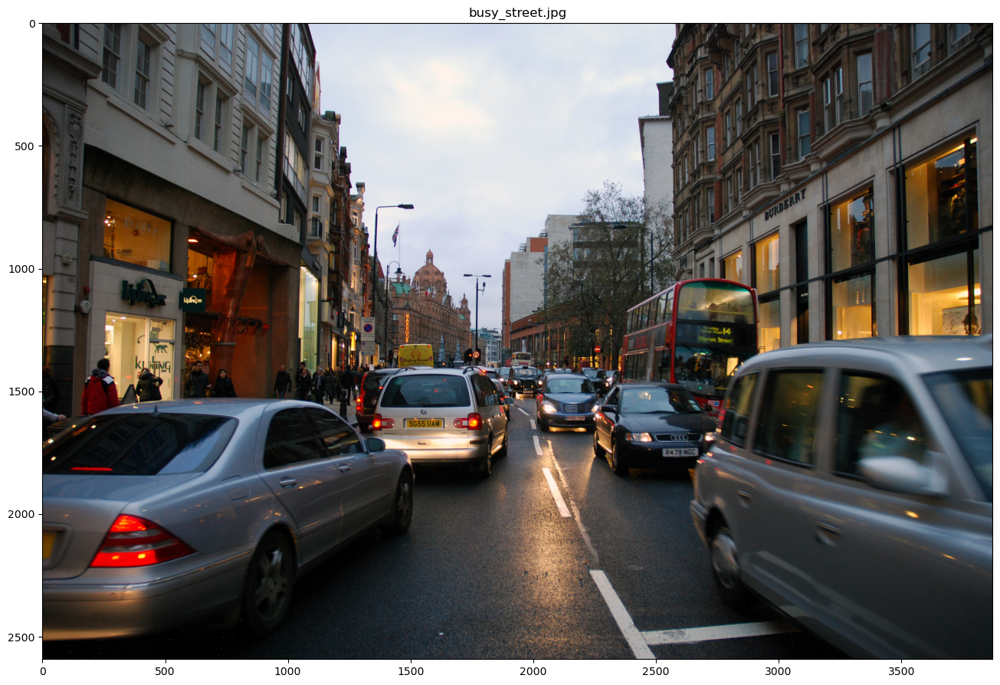

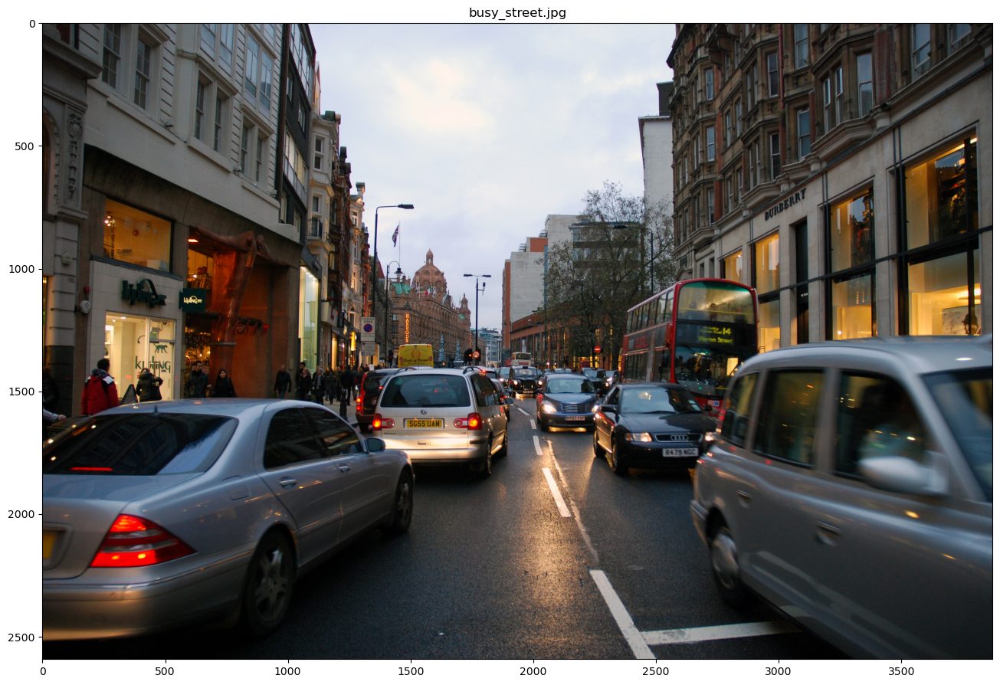

In [8]:
recon_image = original_image.copy()
recon_image[:,:,0] = reconstructed_RGB[0]
recon_image[:,:,1] = reconstructed_RGB[1]
recon_image[:,:,2] = reconstructed_RGB[2]


plt.imshow(recon_image)
plt.title(image_name)
plt.show()

plt.imshow(original_image)
plt.title(image_name)
plt.show()

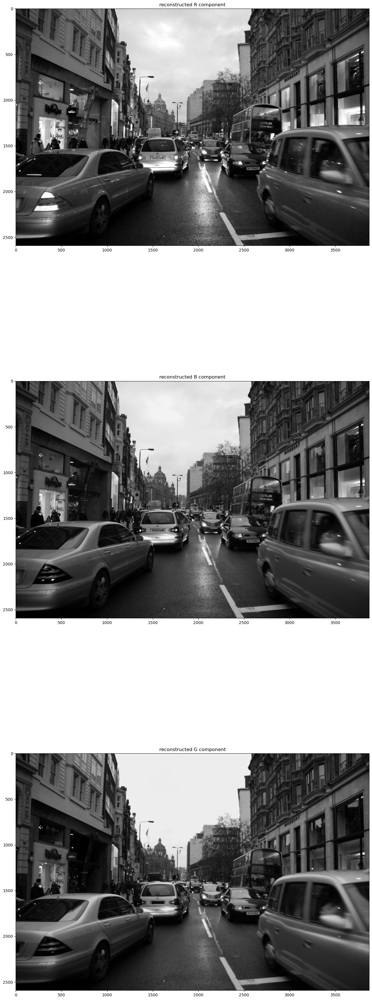

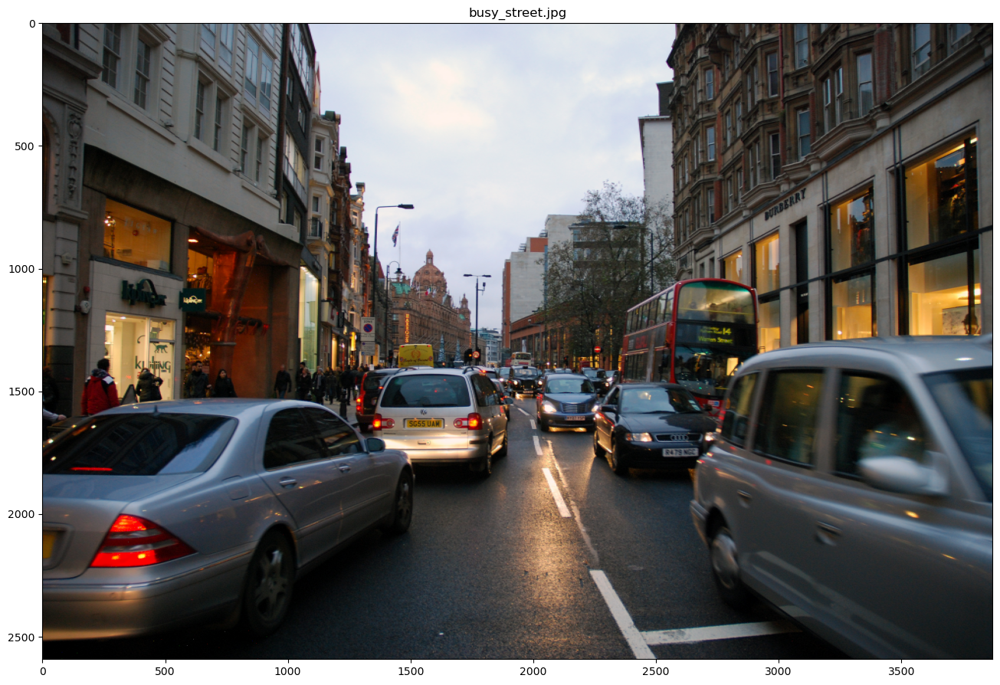

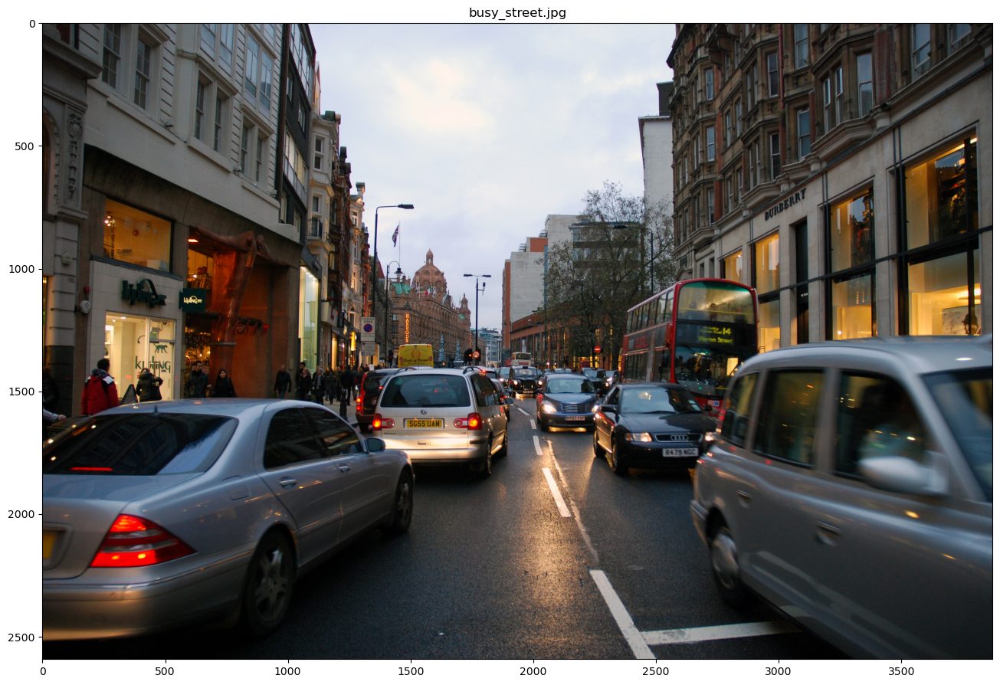

Compression ratio: 
0.375
Compression ratio: 
0.375
Compression ratio: 
0.375


In [9]:
def wavelet_compression_keep_vertical_edges(wavelet_RGB, da_save=True, ad_save=False, dd_save=False):
    
    local_wavelet_RGB = copy.deepcopy(wavelet_RGB)
    masked_values = [None for i in range(len(wavelet_RGB))]
    for idx, component in enumerate(local_wavelet_RGB):
        
        coeff_arr, slice_arr = pywt.coeffs_to_array(component)
        
        mask = coeff_arr.copy()
        
        # Approximative coeff:
        mask[slice_arr[0]] = True
        
        # Verical edges: 
        for i in range(len(slice_arr)-1):
            mask[slice_arr[i+1]['da']] = da_save
        
        # Horizontal edges and diagonals: 
        for i in range(len(slice_arr)-1):
            mask[slice_arr[i+1]['ad']] = ad_save
            mask[slice_arr[i+1]['dd']] = dd_save
        
        coeff_filtered = coeff_arr*mask
        
        masked_values[idx] = mask
        local_wavelet_RGB[idx] = pywt.array_to_coeffs(coeff_filtered, slice_arr, output_format='wavedec2')
        
    return local_wavelet_RGB, masked_values

wavelet_RGB_compressed, masked_values = wavelet_compression_keep_vertical_edges(wavelet_RGB)
#visualize_threshold_compression(wavelet_RGB_compressed, masked_values, titles)

reconstructed_RGB = []

for component in wavelet_RGB_compressed:
    reconstructed_RGB.append(pywt.waverec2(component, wavelet=wavelet))
    
titles = ['reconstructed R component', 'reconstructed B component', 'reconstructed G component']
visualize_RGB_components(reconstructed_RGB, titles)

recon_image = original_image.copy()
recon_image[:,:,0] = reconstructed_RGB[0]
recon_image[:,:,1] = reconstructed_RGB[1]
recon_image[:,:,2] = reconstructed_RGB[2]


plt.imshow(recon_image)
plt.title(image_name)
plt.show()

plt.imshow(original_image)
plt.title(image_name)
plt.show()


for i in range(len(masked_values)):
    print('Compression ratio: ')
    print(np.sum(masked_values[i])/masked_values[i].size)

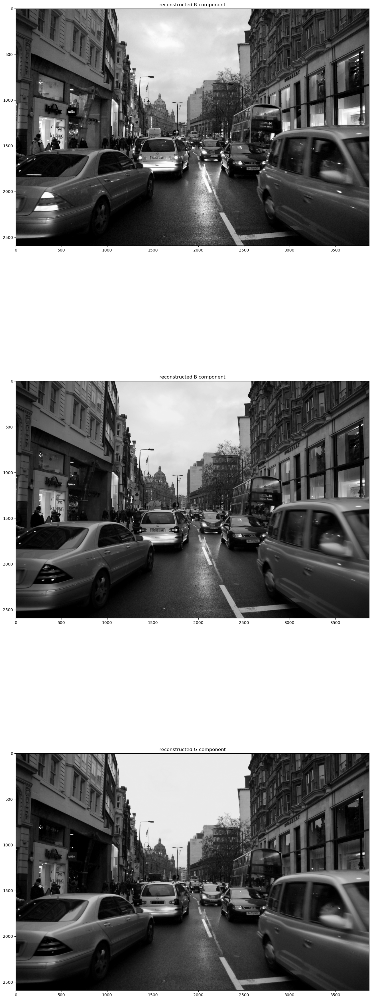

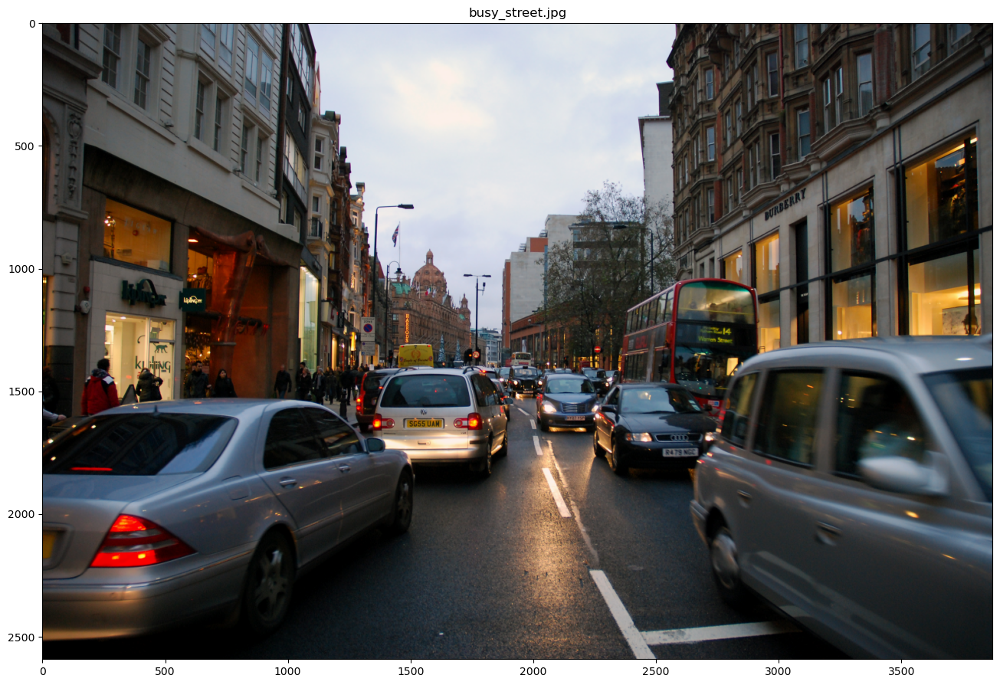

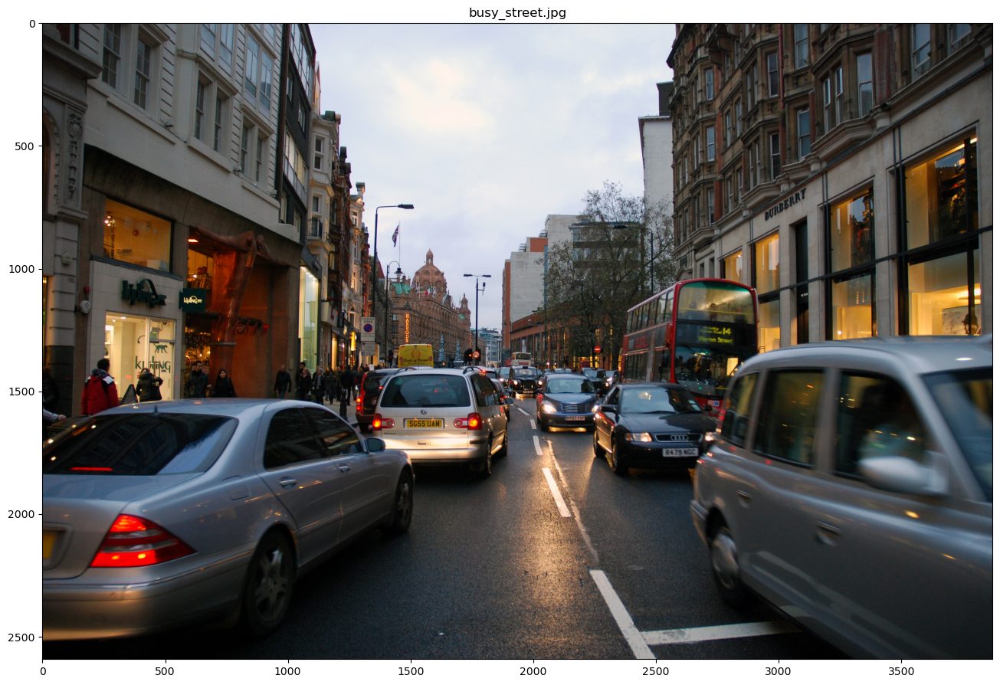

Compression ratio: 
0.2384884992602796

Compression ratio: 
0.23610911832976222

Compression ratio: 
0.22985308020227524



In [10]:
def wavelet_threshold_compression(wavelet_RGB, threshold):
    
    local_wavelet_RGB = copy.deepcopy(wavelet_RGB)
    compresion_ratios = [None for i in range(len(wavelet_RGB))]
    for idx, component in enumerate(local_wavelet_RGB):
        
        coeff_arr, slice_arr = pywt.coeffs_to_array(component)
        ones = np.ones(coeff_arr.shape)
        compresion_ratios[idx] = 1- (np.sum(ones[np.abs(coeff_arr)<threshold]) \
                                  - np.sum(ones[np.isclose(coeff_arr, 0)]))/ones.size
        
        
        coeff_filtered = pywt.threshold(coeff_arr, threshold, mode='soft', substitute=0)
        
        local_wavelet_RGB[idx] = pywt.array_to_coeffs(coeff_filtered, slice_arr, output_format='wavedec2')
        
    return local_wavelet_RGB, compresion_ratios

threshold = 10
wavelet_RGB_compressed, compresion_ratios = wavelet_threshold_compression(wavelet_RGB, threshold)
#visualize_threshold_compression(wavelet_RGB_compressed, masked_values, titles)

reconstructed_RGB = []

for component in wavelet_RGB_compressed:
    reconstructed_RGB.append(pywt.waverec2(component, wavelet=wavelet))
    
titles = ['reconstructed R component', 'reconstructed B component', 'reconstructed G component']
visualize_RGB_components(reconstructed_RGB, titles)

recon_image = original_image.copy()
recon_image[:,:,0] = reconstructed_RGB[0]
recon_image[:,:,1] = reconstructed_RGB[1]
recon_image[:,:,2] = reconstructed_RGB[2]


plt.imshow(recon_image)
plt.title(image_name)
plt.show()

plt.imshow(original_image)
plt.title(image_name)
plt.show()


for i in range(len(masked_values)):
    print('Compression ratio: ')
    print(compresion_ratios[i])
    print('')

In [11]:
import sys
import numpy
from PIL import Image


result = Image.fromarray(recon_image.astype(numpy.uint8))
result.save('compressed.jpg')